# 이미지처리

python에서는 "BGR"!!

## Library

In [1]:
!pip install opencv-python

## 이미지 읽기

In [2]:
import cv2
import numpy as np

from matplotlib import pyplot as plt # 화면출력
import easygui

In [4]:
plt.rcParams['figure.figsize'] = (16,9) #화면 출력 크기

    * 파일경로 및 파일이름에 한글을 지원하지 않음
    * 파일 : image_test.png

In [3]:
img_file = easygui.fileopenbox("Original image")
img_raw = cv2.imread(img_file)

## 이미지 출력

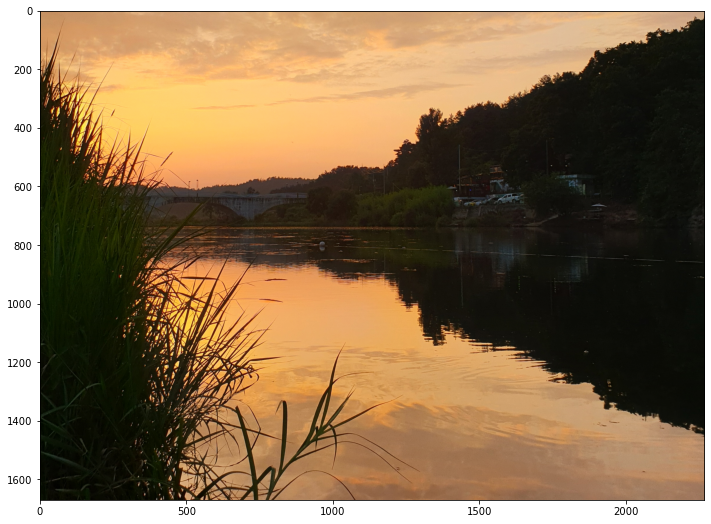

In [6]:
img_rgb  = cv2.cvtColor(img_raw,cv2.COLOR_BGR2RGB) # convert Color - BGR -> RGB

plt.imshow(img_rgb)
plt.show()

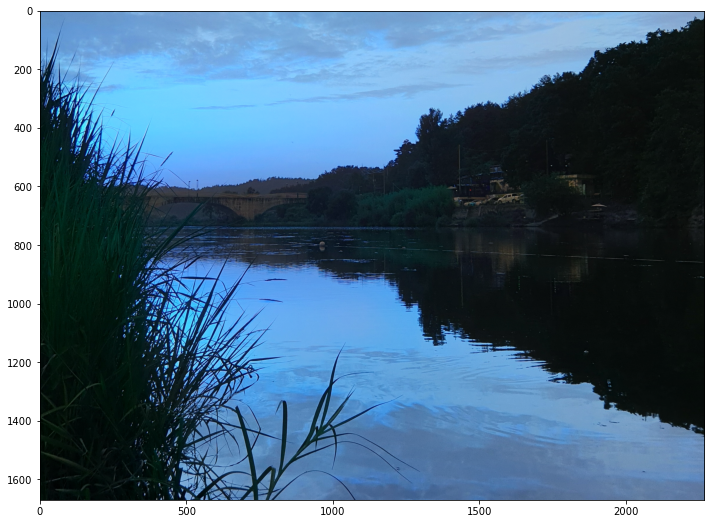

In [8]:
# 변환하지 않을 경우|
plt.imshow(img_raw)
plt.show()

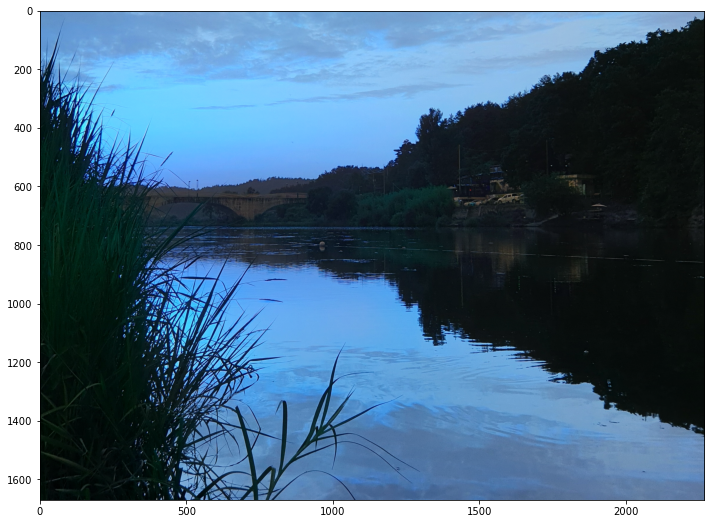

In [9]:
plt.imshow(img_raw)

## 흑백 이미지로 변환

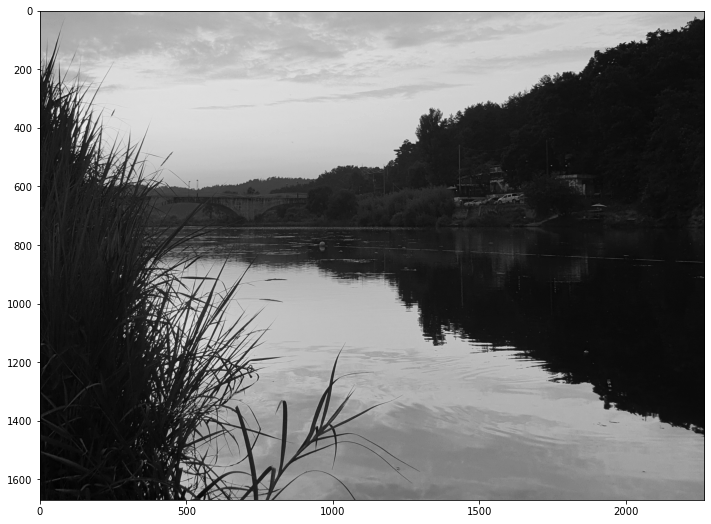

In [10]:
img_gray = cv2.cvtColor(img_raw,cv2.COLOR_BGR2GRAY)
plt.imshow(img_gray,"gray")
plt.show()

In [11]:
img_gray

array([[157, 154, 154, ..., 180, 179, 179],
       [158, 156, 155, ..., 178, 180, 176],
       [158, 158, 158, ..., 175, 175, 173],
       ...,
       [ 18,  18,  18, ..., 125, 125, 127],
       [ 19,  18,  18, ..., 126, 127, 126],
       [ 18,  18,  19, ..., 126, 127, 125]], dtype=uint8)

## 이미지를 파일로 저장


In [12]:
cv2.imwrite("image_test_gray.png", img_gray)

True

## 이미지 크기 변경

In [13]:
img_raw.shape

(1670, 2268, 3)

In [14]:
# 이미지 크기 변경
img_h = int(img_raw.shape[0]/2)
img_w = int(img_raw.shape[1]/2)

# 이미지 크기 절반으로 축소 
img_resize = cv2.resize(img_raw,(img_w,img_h))

# 이미지 크기
img_resize.shape

(835, 1134, 3)

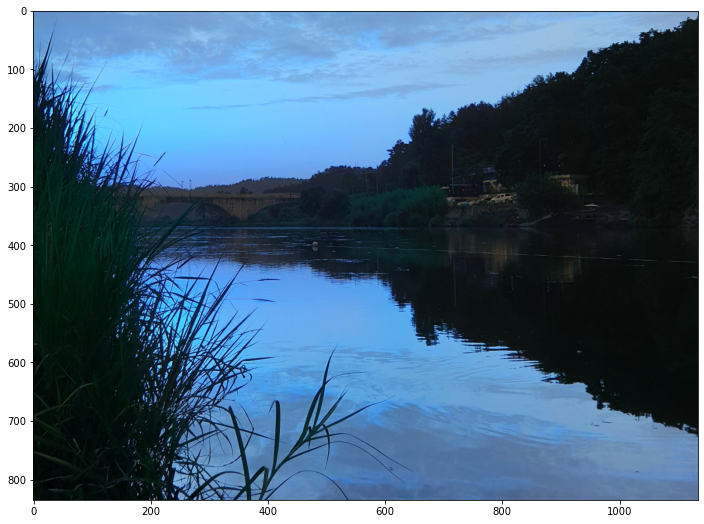

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

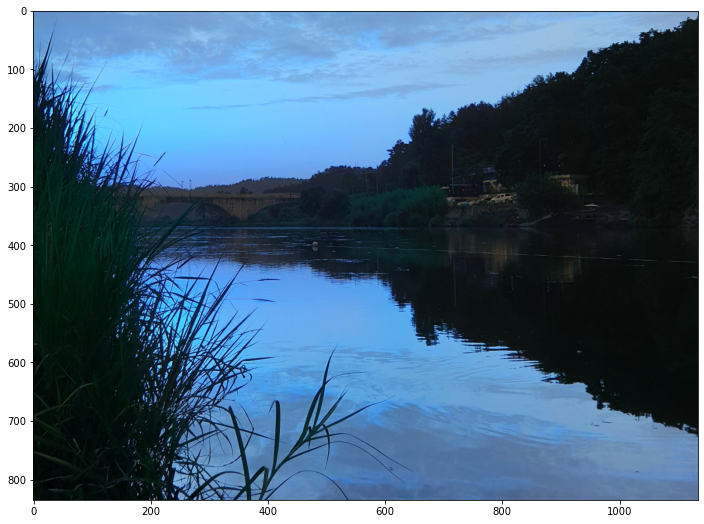

In [17]:
plt.imshow(img_resize,"resize")
plt.show(img_resize)

## 이미지 자르기

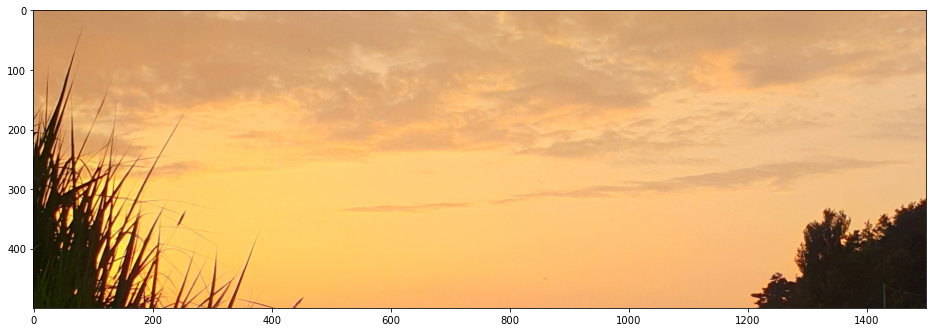

In [18]:
img_cut = img_raw[:500,:1500,:] # h,w,z
# RGB 변환 후 이미지 출력
plt.imshow(cv2.cvtColor(img_cut,cv2.COLOR_BGR2RGB))
plt.show()

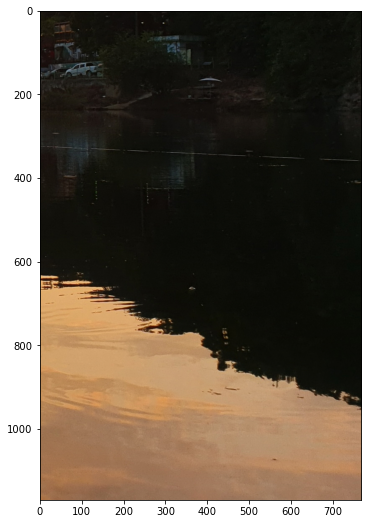

In [19]:
img_cut2 = img_raw[500:,1500:,:] # h,w,z
# RGB 변환 후 이미지 출력
plt.imshow(cv2.cvtColor(img_cut2,cv2.COLOR_BGR2RGB))
plt.show()

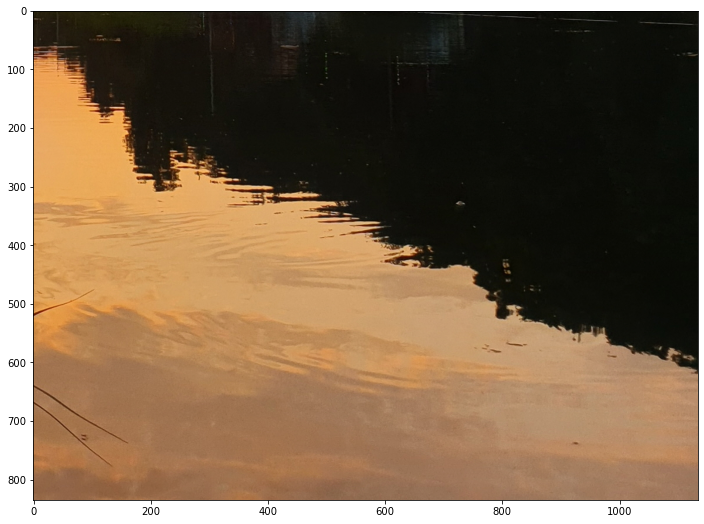

In [20]:

h = int(img_raw.shape[0]/2)
w = int(img_raw.shape[1]/2)


img_cut2 = img_raw[h:,w:,:] # h,w,z
# RGB 변환 후 이미지 출력
plt.imshow(cv2.cvtColor(img_cut2,cv2.COLOR_BGR2RGB))
plt.show()

## 이미지 흐리기 (image blurring)

* 주로 잡음(Noise)을 제거할때
* 컴퓨터가 인식하기 쉬움 (전체적인 패텀을 알기 위해)

In [22]:
# 귀찮아서 
# RGB로 변환 후 이미지 출력
def cov(img):
    plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
    plt.show()

### 평균

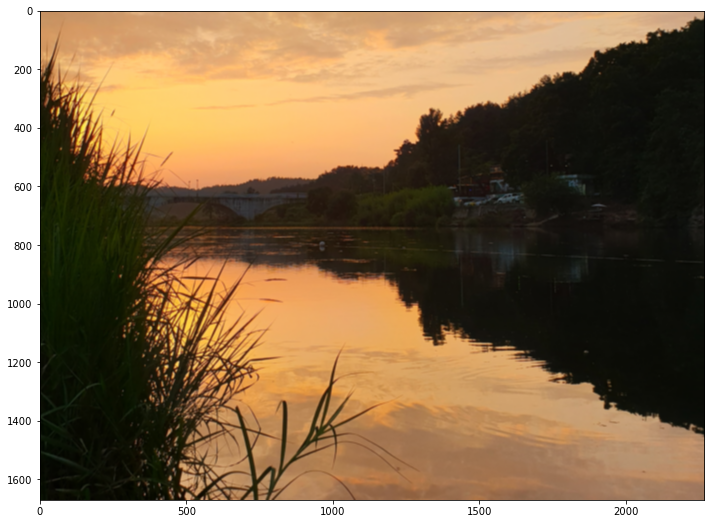

In [23]:

img_blur  = cv2.blur(img_raw,(7,7)) # (7,7) : blur 정도. 클수록 흐려짐.
cov(img_blur)

### 가우시안 - 정규분포

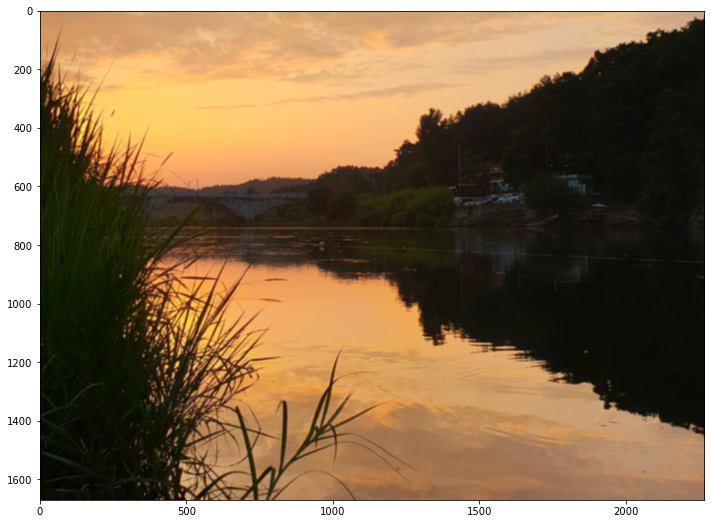

In [24]:

img_gaus  = cv2.GaussianBlur(img_raw,(7,7),sigmaX=25) # (7,7) : blur 정도. 클수록 흐려짐.
cov(img_gaus)

## 밝기와 대비 조정

* 밝기 - 전체적으로 + -
* 대비 - 곱연산 -> 작은값은 작게 큰값은 더욱 크게 변함

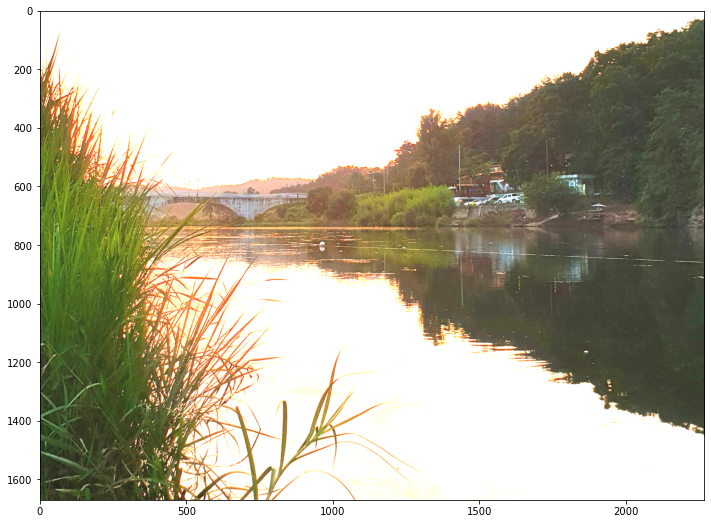

In [25]:
# 대비 # 기울기
alpha = 3
# 밝기 # 절편
beta = 30
# operation: new_image(x,y) = alpha*image(x,y) +beta
image_scale = cv2.convertScaleAbs(img_raw,alpha = alpha, beta = beta)
cov(image_scale)

## 감마 보정

* 감마 <1 : 어두운 -> 밝
* 감마 >1 : 어두운 <- 밝



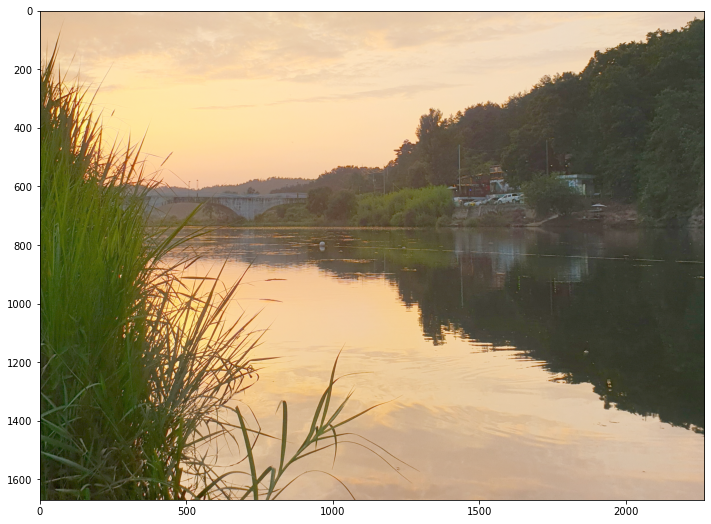

In [33]:
gamma = 0.5

lookUpTable = np.empty((1,256),np.uint8)
for i in range(256):
    lookUpTable[0,i] = np.clip(pow(i/255.0,gamma)* 255.0,0,255)
# lookUpTable = np.array([np.clip(pow(i/255.0,gamma)* 255.0,0,255) for i in range(256)]).T
img_gamma = cv2.LUT(img_raw, lookUpTable)

cov(img_gamma)

## 임계처리 (thresholding)

기준값 (threshold)을 사용하여 화소를 0과 255로 변환

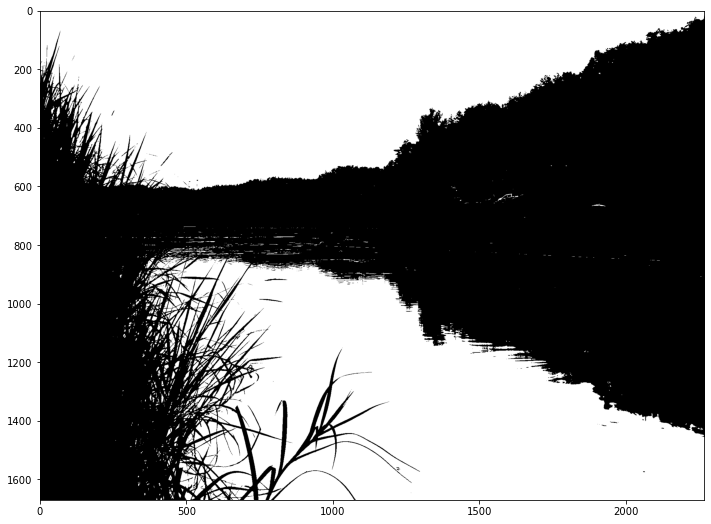

In [72]:
## thresholding
# cv2.htreshold(흑백이미지, 기준값, 기준값 이상, type)
_,img_thresh  = cv2.threshold(img_gray,100,255,cv2.THRESH_BINARY)
# 100보다 크다면 255(흰색) 처리.
cov(img_thresh)

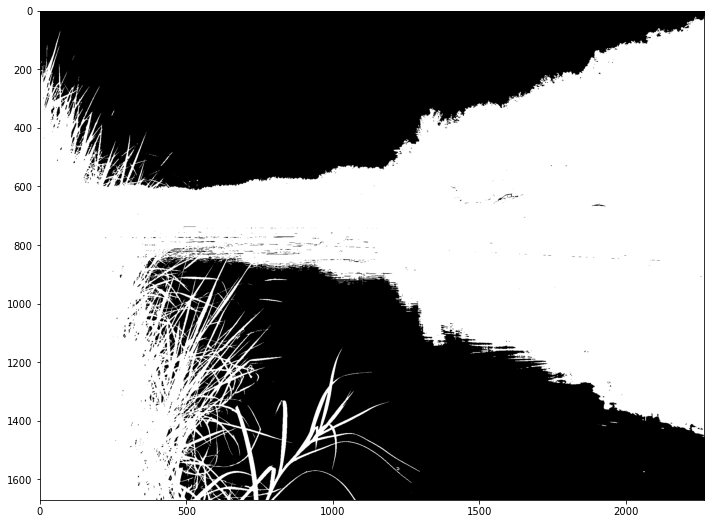

In [70]:
## thresholding
# cv2.htreshold(흑백이미지, 기준값, 기준값 이상, type)
_,img_thresh  = cv2.threshold(img_gray,100,255,cv2.THRESH_BINARY_INV)
# 100보다 크다면 255(흰색) 처리.
cov(img_thresh)

## 경계선(edge) 추출

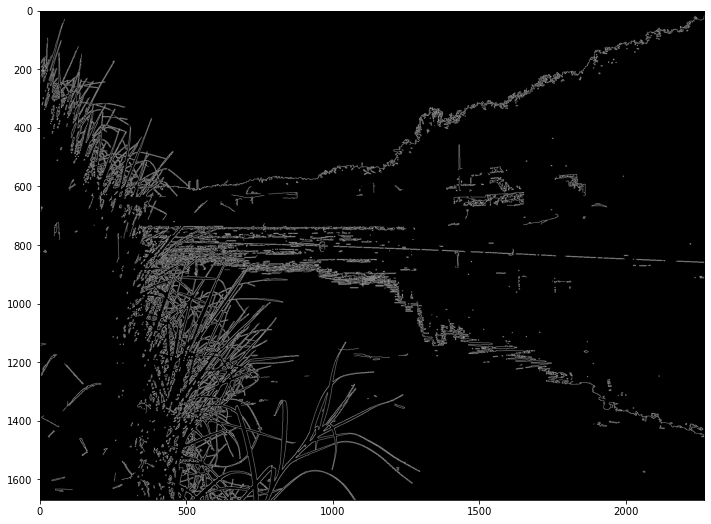

In [36]:
## 캐니(Canny) 경계선 감지기
# image_canny = cv2.Canny(imge_gray, lower_threshold, upper_threshold)
img_canny = cv2.Canny(img_gray, 50, 200)

cov(img_canny)

## 모폴로지연산

* 침식 : 검은색을 확장, 흰색의 크기를 축소

In [39]:
## 커널 (윈도우)
kernel = np.ones((7,7),np.uint8)

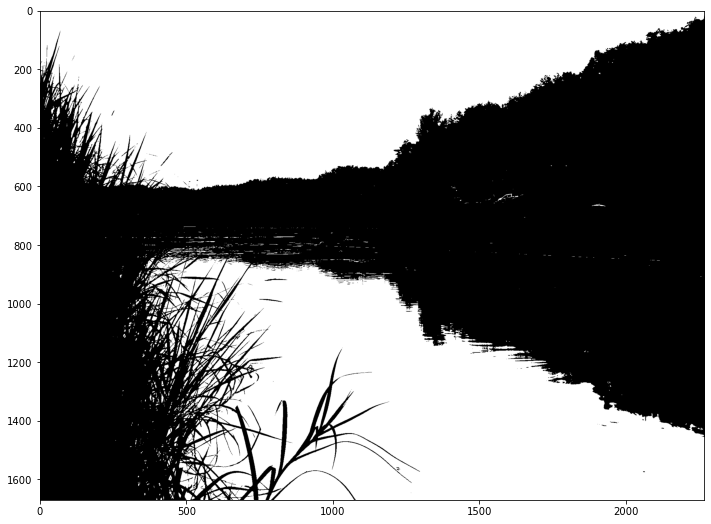

In [47]:
# 원래
cov(img_thresh)

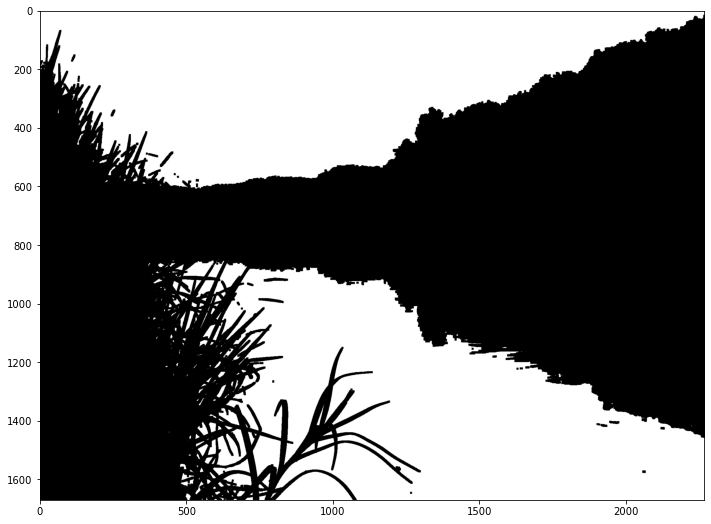

In [40]:
## 침식 연산
img_erode = cv2.erode(img_thresh, kernel)

cov(img_erode)

* 팽창 : 흰색 확장 검은색 축소

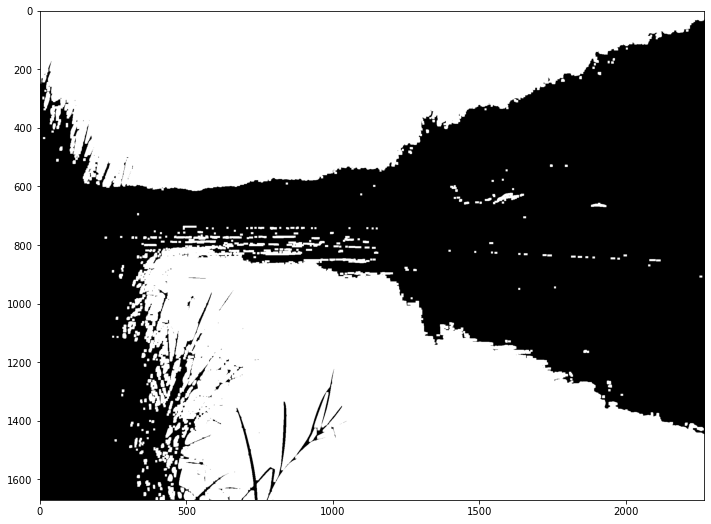

In [44]:
#팽창 연산(Dilation)
img_dilate = cv2.dilate(img_thresh,kernel)
cov(img_dilate)

* 열림(Opening) : 침식 후 팽창 


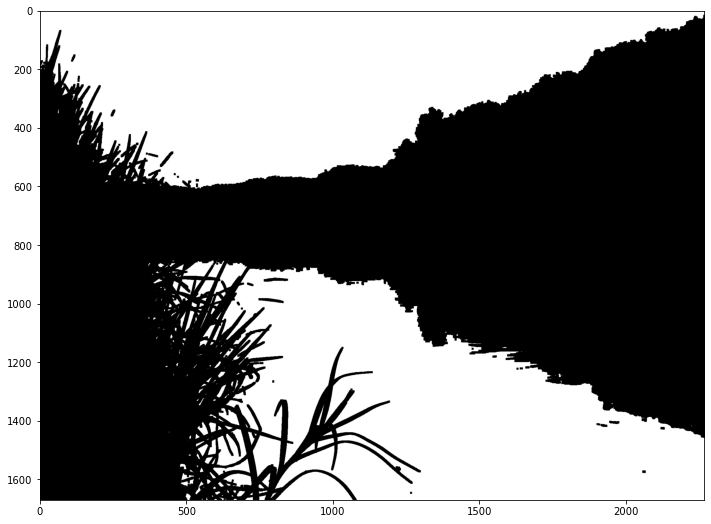

In [48]:
cov(img_erode) # 침식

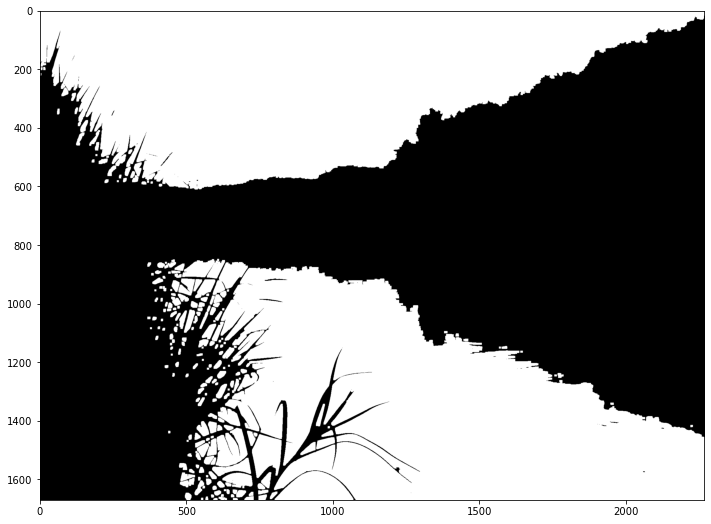

In [49]:
## 열림 연산

img_open = cv2.morphologyEx(img_thresh, cv2.MORPH_OPEN,kernel)

cov(img_open)
# 윤곽선과 잡음이 줄어들었다

* 닫힘 : 팽창 후 침식 : 잡음 제거

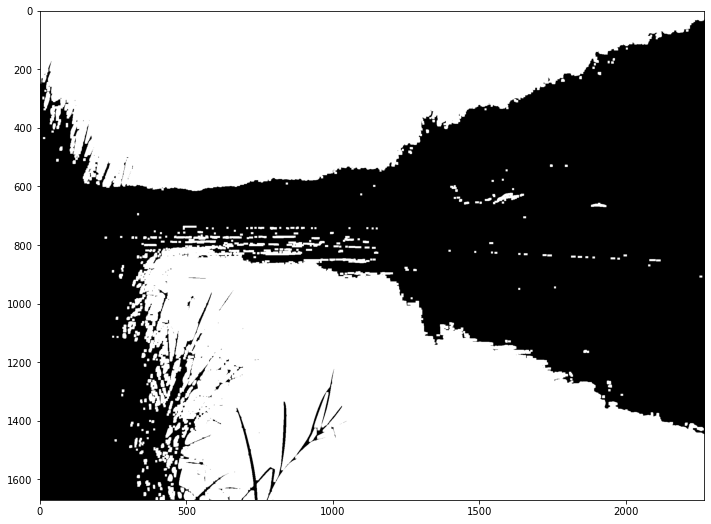

In [50]:
# 팽창
cov(img_dilate)

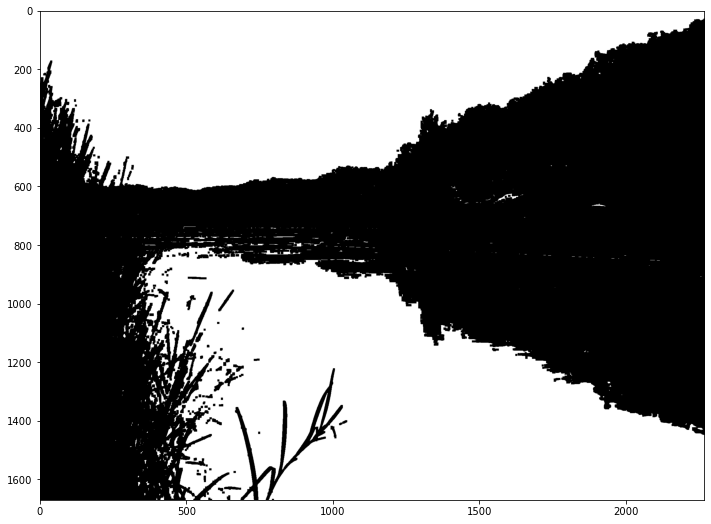

In [46]:
## 닫힘 연산
img_close = cv2.morphologyEx(img_thresh, cv2.MORPH_CLOSE, kernel)
cov(img_close)

### 이미지 혼합( image blending )

In [54]:
def read():
    img = cv2.imread(easygui.fileopenbox("img"))
    return img

In [77]:
img1=read()

In [78]:
img2=read()

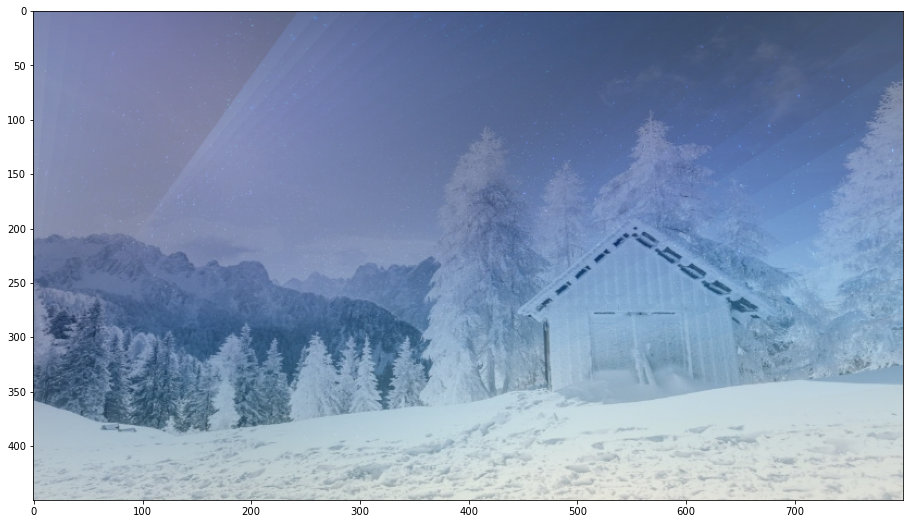

In [79]:
img_blending = cv2.addWeighted(img1, 0.5, img2, 0.5, 0)

cov(img_blending)

## 이미지 삽입

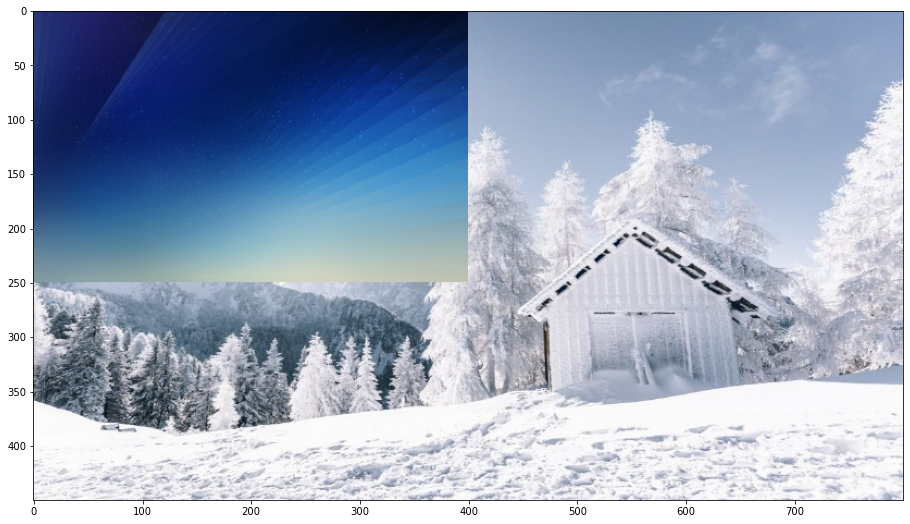

In [83]:
img1_tmp = img1.copy()
img2_tmp = cv2.resize(img2, (400,250)) # w,h

rows1, cols1, channels1 = img1_tmp.shape
rows2, cols2, channels2 = img2_tmp.shape

img1_tmp[0:rows2,0:cols2] = img2_tmp

cov(img1_tmp)

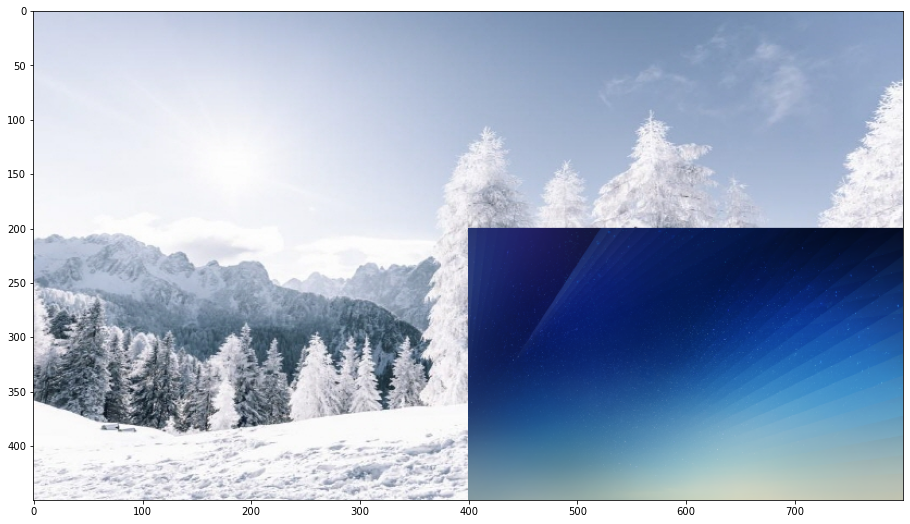

In [97]:
img1_tmp = img1.copy()
img2_tmp = cv2.resize(img2, (400,250)) # w,h

rows1, cols1, channels1 = img1_tmp.shape
rows2, cols2, channels2 = img2_tmp.shape

img1_tmp[(rows1-rows2):,(cols1-cols2):] = img2_tmp

cov(img1_tmp)

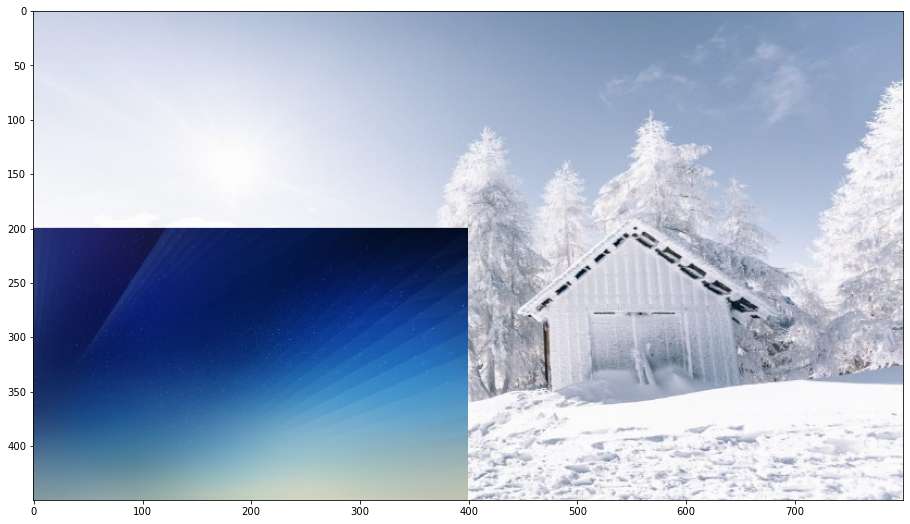

In [98]:
img1_tmp = img1.copy()
img2_tmp = cv2.resize(img2, (400,250)) # w,h

rows1, cols1, channels1 = img1_tmp.shape
rows2, cols2, channels2 = img2_tmp.shape

img1_tmp[(rows1-rows2):,0:cols2] = img2_tmp

cov(img1_tmp)

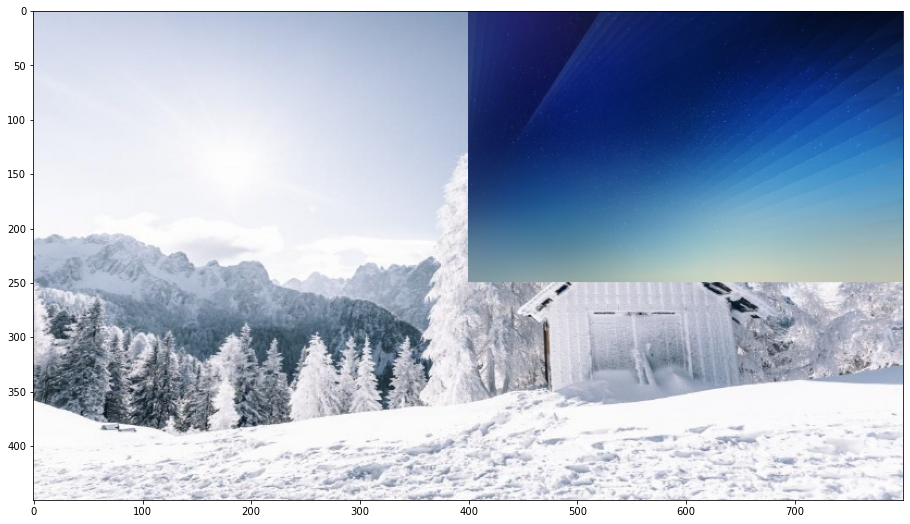

In [99]:
img1_tmp = img1.copy()
img2_tmp = cv2.resize(img2, (400,250)) # w,h

rows1, cols1, channels1 = img1_tmp.shape
rows2, cols2, channels2 = img2_tmp.shape

img1_tmp[0:rows2,(cols2-cols1):] = img2_tmp

cov(img1_tmp)

In [100]:
rows1, cols1, channels1 = img1_tmp.shape

In [101]:
rows1/2

225.0

In [102]:
cols1/2

400.0

In [103]:
rows2, cols2, channels2 = img2_tmp.shape

In [105]:
rows2

250

In [106]:
rows2/2

125.0

In [112]:
int(rows1/2-rows2/2)

100

In [113]:
int(rows1/2+rows2/2)

350

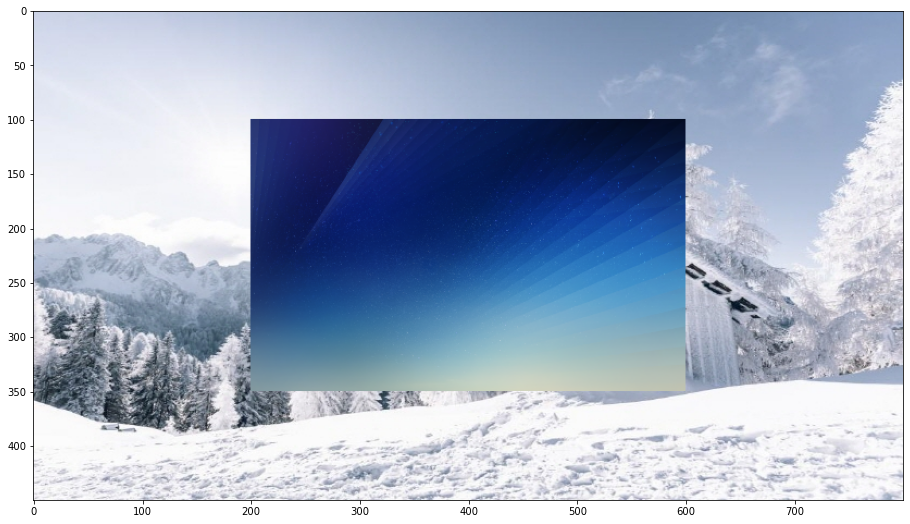

In [124]:
img1_tmp = img1.copy()
img2_tmp = cv2.resize(img2, (400,250)) # w,h

rows1, cols1, channels1 = img1_tmp.shape
rows2, cols2, channels2 = img2_tmp.shape


img1_tmp[(rows1//2-rows2//2):(rows1//2+rows2//2),(cols1//2-cols2//2):(cols1//2+cols2//2)] = img2_tmp

cov(img1_tmp)

In [123]:
(cols1/2-cols2/2)

360.0

In [117]:
(cols1/2+cols2/2)

600.0

## 연습문제

In [125]:
chick = read()

filter : cv2.bilateralFilter 



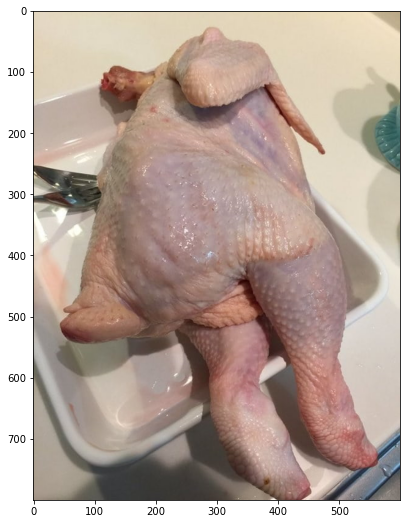

In [126]:
cov(chick)

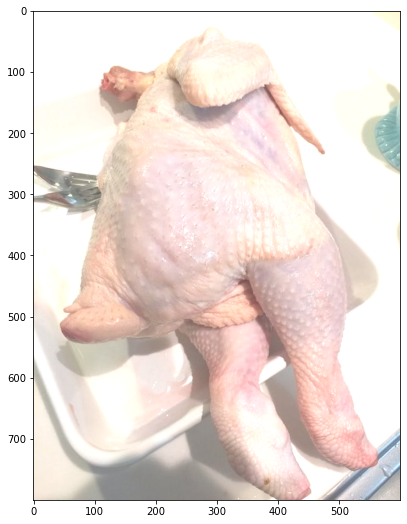

In [220]:
# 대비 # 기울기
alpha = 1
# 밝기 # 절편
beta = 80
# operation: new_image(x,y) = alpha*image(x,y) +beta
chick_scale = cv2.convertScaleAbs(chick,alpha = alpha, beta = beta)
cov(chick_scale)

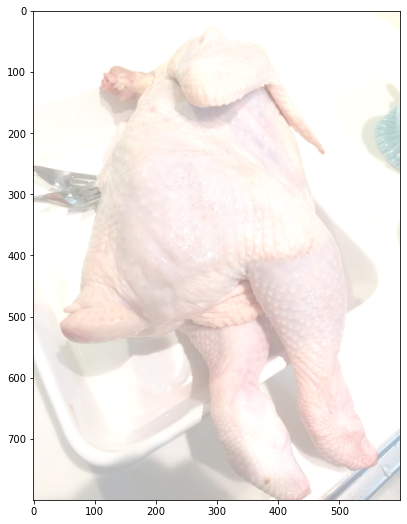

In [221]:
gamma = 0.5

lookUpTable = np.empty((1,256),np.uint8)
for i in range(256):
    lookUpTable[0,i] = np.clip(pow(i/255.0,gamma)* 255.0,0,255)
# lookUpTable = np.array([np.clip(pow(i/255.0,gamma)* 255.0,0,255) for i in range(256)]).T
chick_gamma = cv2.LUT(chick_scale, lookUpTable)

cov(chick_gamma)

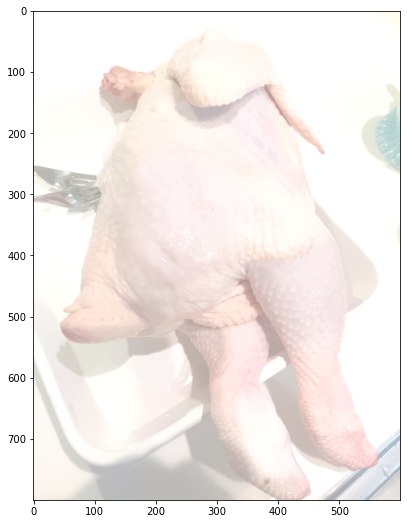

In [224]:
img_bil = cv2.bilateralFilter(chick_gamma,51,10,100)
cov(img_bil)

## 얼굴인식

In [225]:
import cv2
import easygui
from matplotlib import pyplot as plt

In [226]:
plt.rcParams['figure.figsize'] = (16,9)

In [239]:
cascade_file = 'haarcascade_frontalface_alt.xml'

In [229]:
# bp.jpg
image = read()

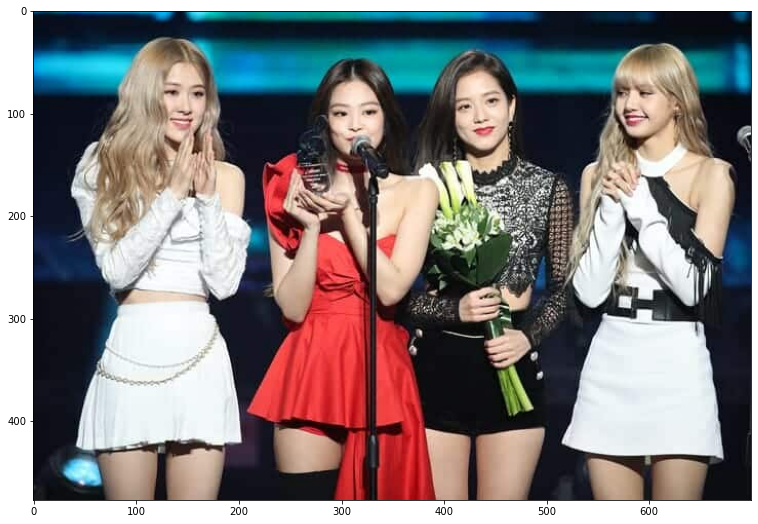

In [240]:
cov(image)

In [241]:
# 그레이스케일로 변환
image_gs = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
# 캐스케이드
cascade = cv2.CascadeClassifier(cascade_file)


In [242]:
cascade

<CascadeClassifier 000001E280369B90>

In [263]:
# 얼굴인식 실행
face_list = cascade.detectMultiScale(image_gs, minSize=(30,30))
#인식한 얼굴의 좌표
face_list

array([[116,  56,  63,  63],
       [550,  51,  73,  73],
       [281,  75,  65,  65],
       [401,  65,  69,  69]], dtype=int32)

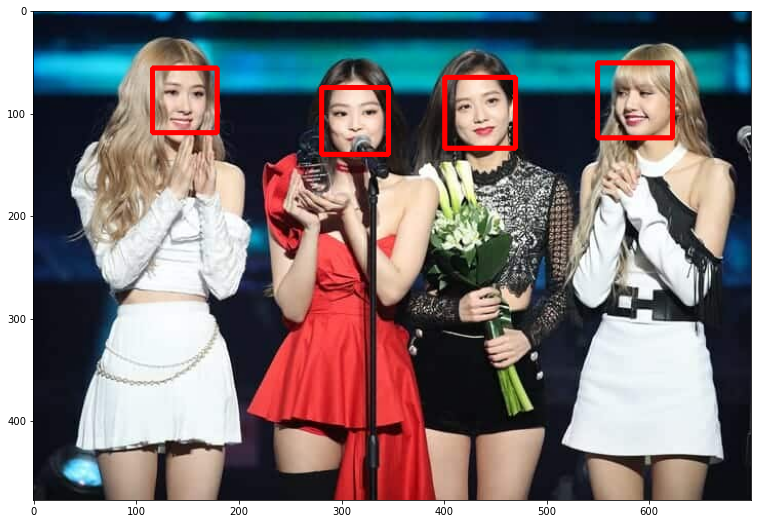

In [264]:
## 얼굴 좌표 확인
if len(face_list) >0:
    image_face = image.copy()
    color = (0,0,255)
    # 얼굴 영역 표시
    for face in face_list:
        x,y,w,h = face
        #왼쪽위, 오른쪽아래 color로 표시
        cv2.rectangle(image_face,(x,y), (x+w, y+h), color, thickness = 3)
        
    # RGB로 변환후 이미지 출력
    plt.imshow(cv2.cvtColor(image_face, cv2.COLOR_BGR2RGB))
else: #detect한 얼굴 없음
    print("얼굴 없다")

## 모자이크 처리

In [267]:
def face_mosaic1(img,rect, size=9):
    x1,y1,x2,y2 = rect
    w = x2-x1
    h = y2-y1
    img_small = cv2.resize(img[y1:y2,x1:x2],(size,size))
    img[y1:y2, x1:x2] = cv2.resize(img_small, (w,h))
    return img

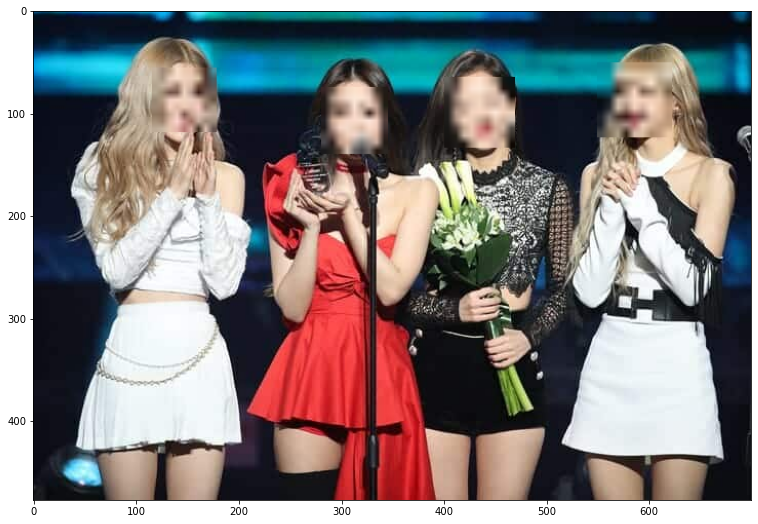

In [268]:
image_new = image.copy()
for x,y,w,h in face_list:
    image_new = face_mosaic1(image_new, (x,y,x+w, y+h))

cov(image_new)

In [272]:
def face_mosaic2(img,rect, size=9):
    x1,y1,x2,y2 = rect
    w = x2-x1
    h = y2-y1
    img_small = cv2.resize(img[y1:y2,x1:x2],(size,size))
    img[y1:y2, x1:x2] = cv2.resize(img_small, (w,h), interpolation = cv2.INTER_AREA)
    return img

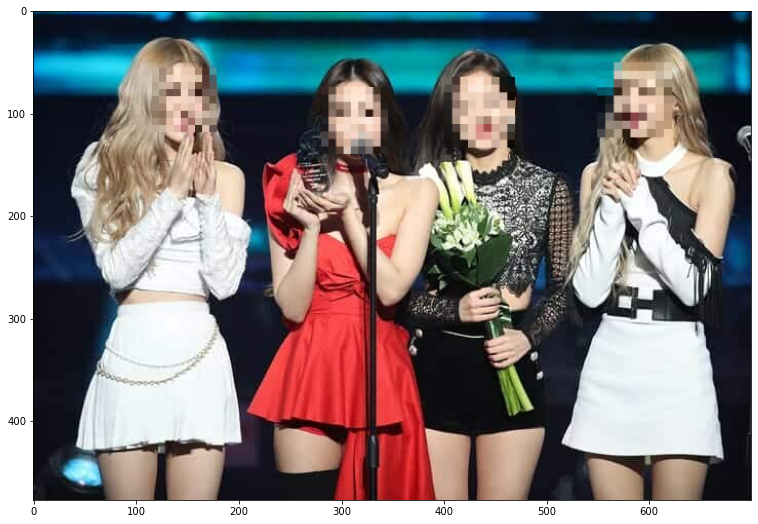

In [273]:
image_new = image.copy()
for x,y,w,h in face_list:
    image_new = face_mosaic2(image_new, (x,y,x+w, y+h))

cov(image_new)

## 로고 넣기

In [274]:
def face_change(img,img_c,rect):
    x1,y1,x2,y2 = rect
    w = x2-x1
    h = y2-y1
    
    img[(y2-h):y2, x1:(x1+w)] = cv2.resize(img_c, (w,h))
    return img

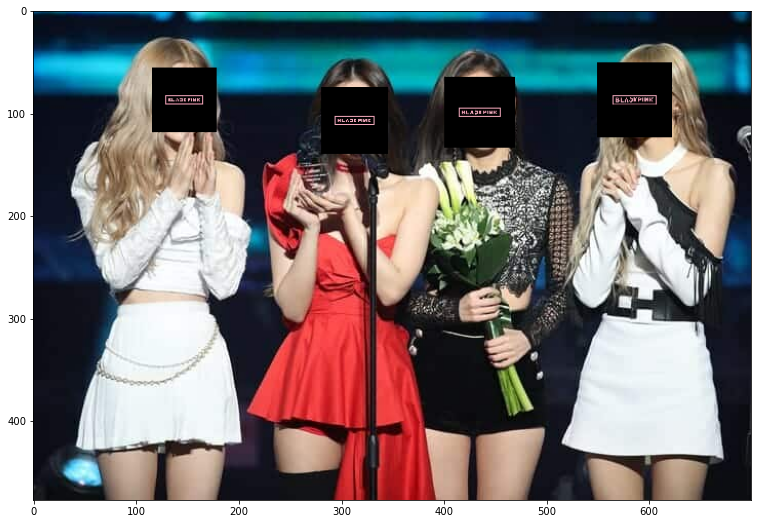

In [283]:
image_new = image.copy()
for x,y,w,h in face_list:
    image_new = face_change(image_new, img_c, (x,y,x+w,y+h))
cov(image_new)

In [275]:
def add_stars(img,img_c,rect):
    x1,y1,x2,y2 = rect
    w = x2-x1
    h = y2-y1
    img_c = cv2.resize(img_c,(w,h)) # detect한 사각형 크기에 맞게 resize
    img_back = img[y1:y2,x1:x2] 
    img[y1:y2,x1:x2] = cv2.add(img_back,img_c) # 해당 부분을 img_c에 바꿈
    return img

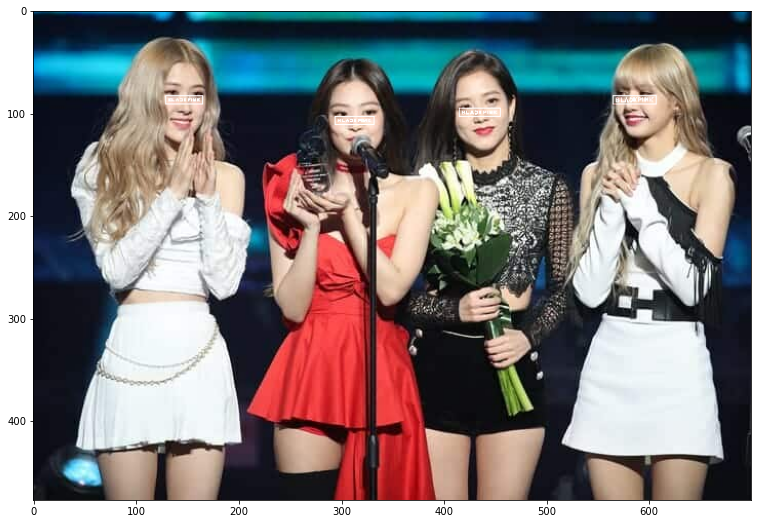

In [285]:
image_new = image.copy()
for x,y,w,h in face_list:
    image_new = add_stars(image_new, img_c, (x,y,x+w,y+h))
cov(image_new)

In [276]:
img_c = read()

## 웹캠 얼굴 인식

In [282]:
import cv2

cap = cv2.VideoCapture(0)
cap.set(3,640)
cap.set(4,480)

face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_alt.xml')

while(True):
    # frame 별로 capture
    ret, frame = cap.read()
    
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    faces = face_cascade.detectMultiScale(gray, 1.3, 5)
    
    # 얼굴에 사각형 출력
    for(x,y,w,h) in faces:
        cv2.rectangle(frame,(x,y),(x+w,y+h),(255,0,0),2)
        
        #화면 출력
        cv2.imshow('frame',frame)
        
        # 종료
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
cap.release()
cv2.destroyAllWindows()

KeyboardInterrupt: 

## 번호판 인식

1. 이진영상 ( 연속 숫자열 검출 위해)
2. 왜곡 보정 / 정규화 ( 잡음 제거)
3. 모폴로지 ( 대비 올림 ) 
4. 색 이진화
5. 개별 문자 추출
6. 개별 문자 정규
7. 인식

In [1]:
!pip install pytesseract

In [2]:
import cv2
import numpy as np
from matplotlib import pyplot as plt

In [3]:
plt.rcParams['figure.figsize'] = (16,9)

In [47]:
import pytesseract
pytesseract.pytesseract.tesseract_cmd = '‪C:\\Program Files\\TesseractOCR\\tesseract'

In [49]:
tesseract_path = 'C:\Program Files\TesseractOCR'
pytesseract.pytesseract.tesseract_cmd = tesseract_path +'/tesseract'

In [5]:
import easygui

In [6]:
img_file = easygui.fileopenbox('Input image')

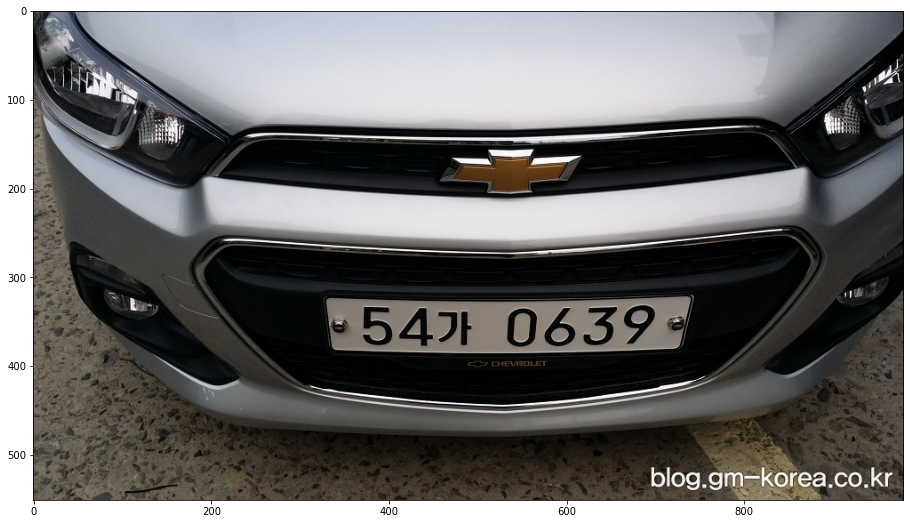

In [7]:
img_raw = cv2.imread(img_file)
plt.imshow(cv2.cvtColor(img_raw,cv2.COLOR_BGR2RGB))

In [10]:
img_raw.shape # (세로, 가로 , 색)

(551, 980, 3)

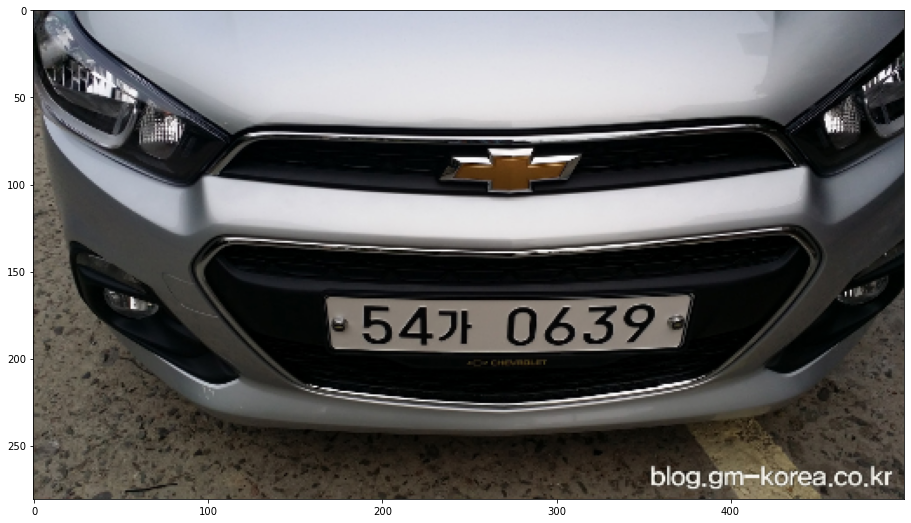

In [8]:
# 이미지 크기 변경

ratio_w = 500/img_raw.shape[1] 
img_h = int(img_raw.shape[0]*ratio_w)
img_w = int(img_raw.shape[1]*ratio_w)
# 가로 길이를 500으로 하는데 같은 비율로 높이 변경


# 이미지 크기 변경 (너비, 높이)
img_resize = cv2.resize(img_raw, (img_w, img_h))

# RGB로 변환 후 이미지 출력
plt.imshow(cv2.cvtColor(img_resize,cv2.COLOR_BGR2RGB))

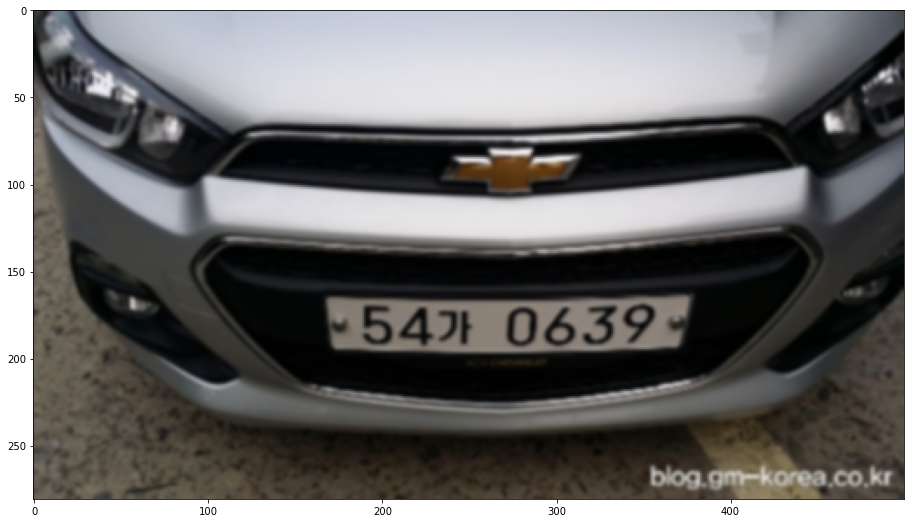

In [16]:
# GussianBlur
img_gaus = cv2.GaussianBlur(img_resize, (5,5), 0)

plt.imshow(cv2.cvtColor(img_gaus, cv2.COLOR_BGR2RGB))

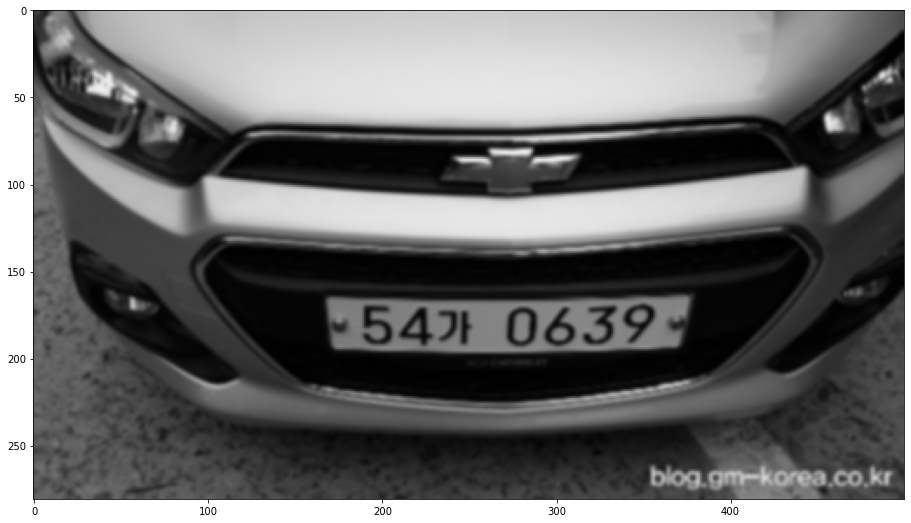

In [17]:
# 흑백이미지 
img_gray = cv2.cvtColor(img_gaus, cv2.COLOR_BGR2GRAY)

# RGB로 변환 후 이미지 출력
plt.imshow(cv2.cvtColor(img_gray,cv2.COLOR_BGR2RGB))

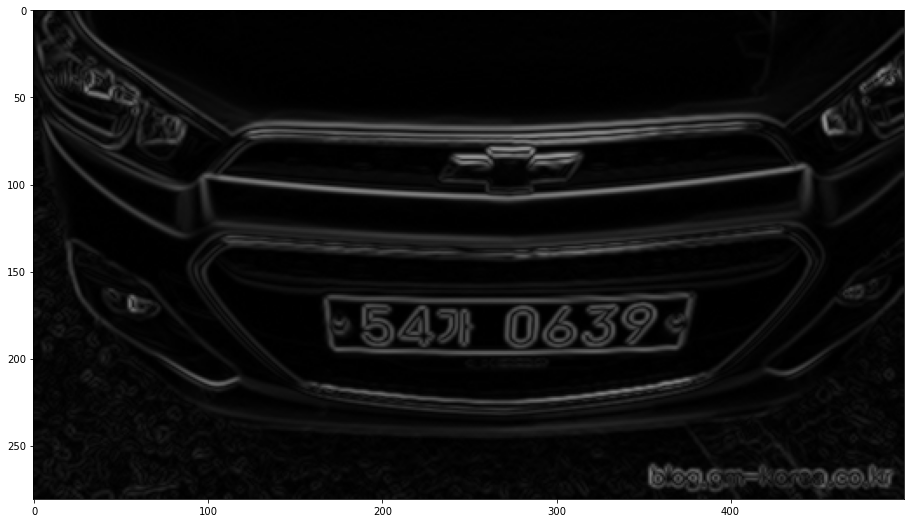

In [21]:
# 윤곽선
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
image_mg = cv2.morphologyEx(img_gray, cv2.MORPH_GRADIENT,kernel)

plt.imshow(cv2.cvtColor(image_mg, cv2.COLOR_BGR2RGB))

In [22]:
def cov(img):
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

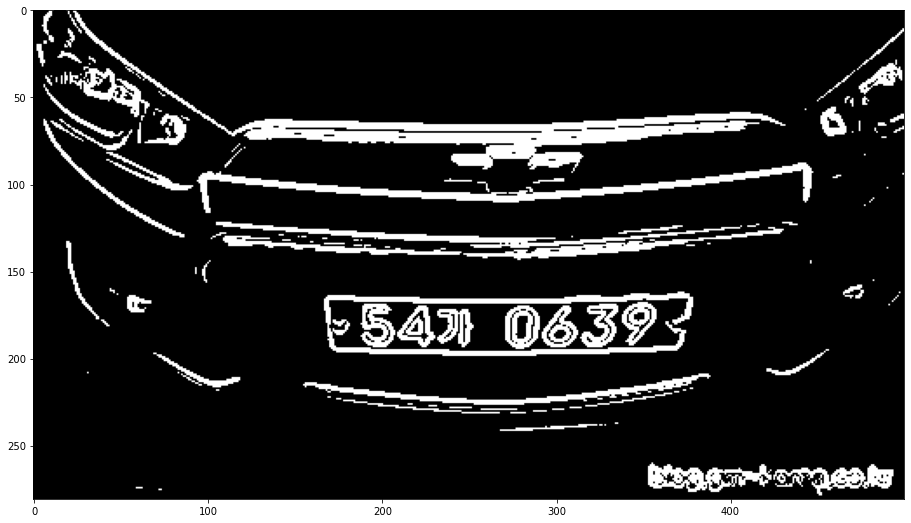

In [23]:
## 이미지 이진화 - thresholding
# 햐얀 윤곽선을 두껍게
_, image_bw = cv2.threshold(image_mg, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)

cov(image_bw)

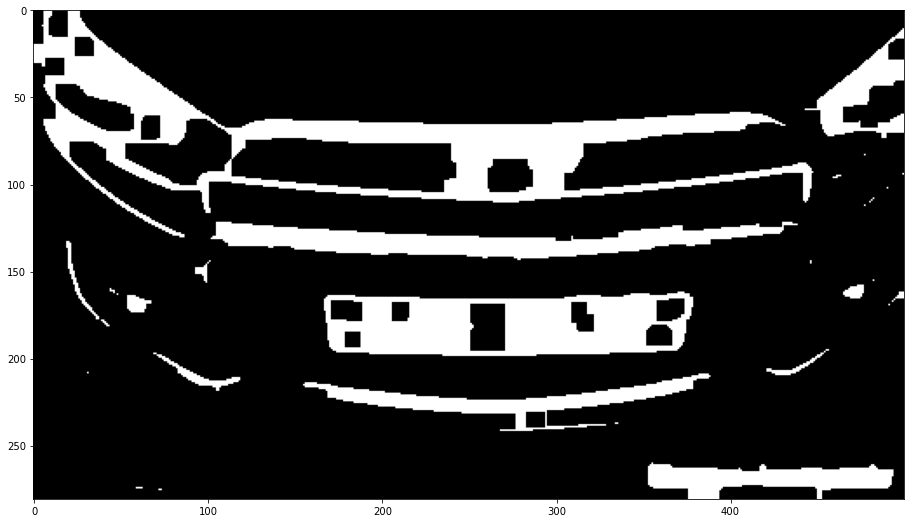

In [25]:
## image closing 
# 번호판 detect 위해서
# 하얀 면적이 크고 너비가 긴 사각형 = 번호판!
kernel =  cv2.getStructuringElement(cv2.MORPH_RECT,(9,9))
image_mc = cv2.morphologyEx(image_bw, cv2.MORPH_CLOSE,kernel)

cov(image_mc)

### 이미지 컨투어

In [26]:
# 이미지에서 윤곽 찾기
contours, hierarchy = cv2.findContours(image_mc.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

In [27]:
## 차량번호 저장
car_num = []

In [52]:
contours  # 사각형들 좌표

[array([[[ 72, 275]],
 
        [[ 73, 275]]], dtype=int32),
 array([[[ 59, 274]],
 
        [[ 60, 274]],
 
        [[ 61, 274]],
 
        [[ 62, 274]],
 
        [[ 61, 274]],
 
        [[ 60, 274]]], dtype=int32),
 array([[[355, 260]],
 
        [[354, 261]],
 
        [[353, 262]],
 
        [[353, 263]],
 
        [[353, 264]],
 
        [[353, 265]],
 
        [[353, 266]],
 
        [[353, 267]],
 
        [[353, 268]],
 
        [[353, 269]],
 
        [[353, 270]],
 
        [[353, 271]],
 
        [[353, 272]],
 
        [[354, 273]],
 
        [[355, 273]],
 
        [[356, 274]],
 
        [[357, 274]],
 
        [[358, 274]],
 
        [[359, 274]],
 
        [[360, 274]],
 
        [[361, 274]],
 
        [[362, 274]],
 
        [[363, 274]],
 
        [[364, 274]],
 
        [[365, 274]],
 
        [[366, 274]],
 
        [[367, 274]],
 
        [[368, 274]],
 
        [[369, 274]],
 
        [[370, 274]],
 
        [[371, 274]],
 
        [[372, 274]],
 
        [[373,

In [50]:
## 컨투어 검색

for idx in range(len(contours)):
    x,y,w,h = cv2.boundingRect(contours[idx])
    # 컨투어 내부 회색 비율
    # 검은색(0,0,0)이 아닌 것만 count (countNonZero)
    ratio = float(cv2.countNonZero(image_mc[y:y+h, x:x+w]))/(w*h)
    #번호판 식별 기준
    # 사각형이 전체 크기에 절반 이상, 너비가 150, 높이가 25 이상
    
    if ratio > 0.5 and w > 150 and h > 25: 
        #사각형 표시 (detect)
        cv2.rectangle(img_gaus, (x,y), (x+w-1, y+h-1),(0,255,0),2)
        # 숫자로 변환 위해.
        # 이미지 자르기
        img_sub = img_gray[y:y+h, x:x+w] 
        # 이미지 이진화 검은색이 아니라면 255(흰색)
        _, img_sub = cv2.threshold(img_sub, 0 ,255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
        # 추출된 이미지에서 글자 추출
        str = pytesseract.image_to_string(img_sub, lang = 'kor+eng')
        # 차량번호 저장
        car_num.append(str)

In [40]:
car_num

[str, '54가 0639\n\x0c']

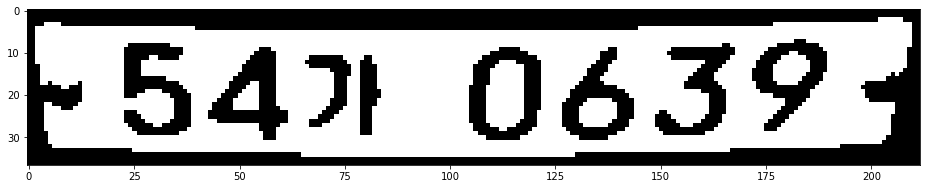

In [51]:
cov(img_sub)


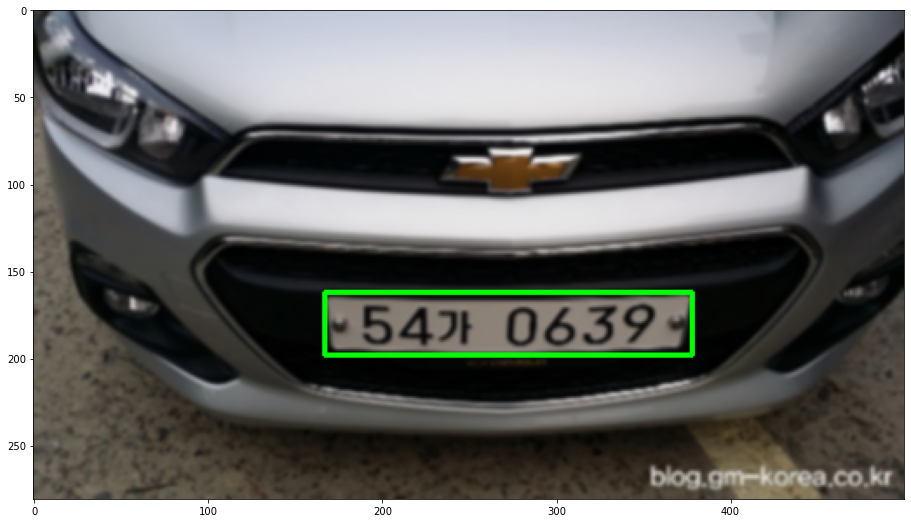

In [53]:
cov(img_gaus)

### 연습문제


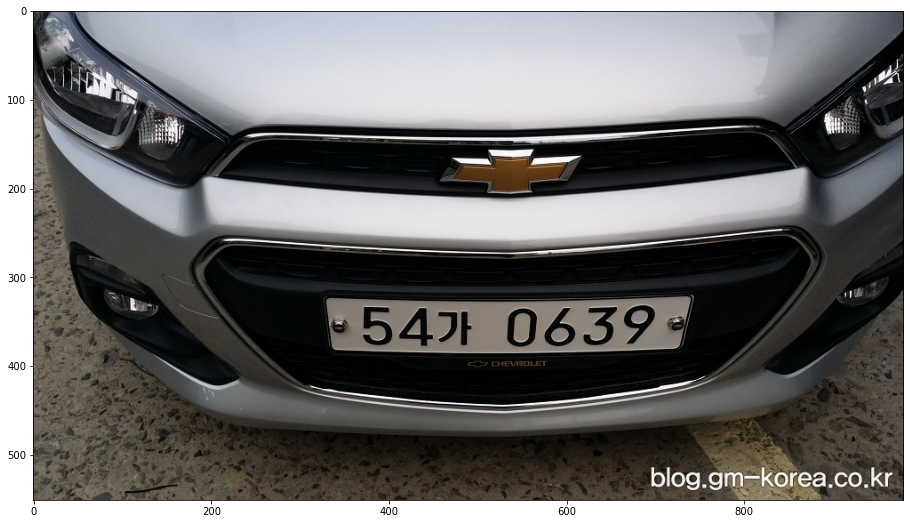

In [55]:
img_raw2 = read()
plt.imshow(cv2.cvtColor(img_raw,cv2.COLOR_BGR2RGB))

In [58]:
img_raw2.shape # (세로, 가로 , 색)

(571, 851, 3)

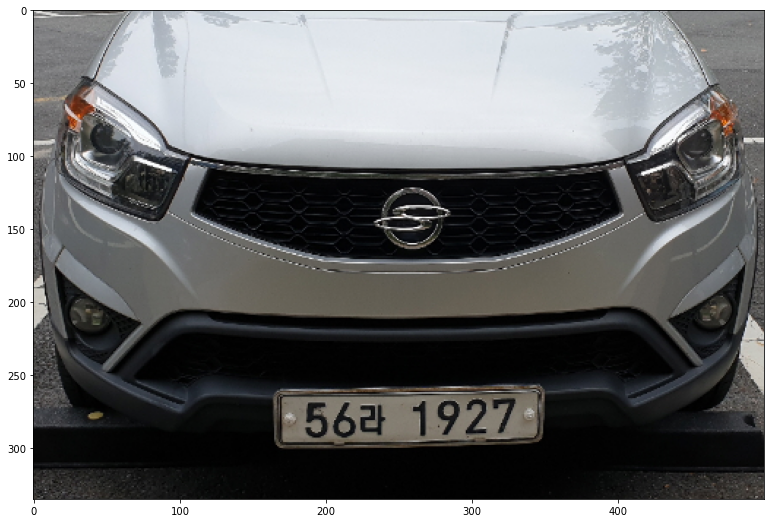

In [59]:
# 이미지 크기 변경

ratio_w = 500/img_raw2.shape[1] 
img_h = int(img_raw2.shape[0]*ratio_w)
img_w = int(img_raw2.shape[1]*ratio_w)
# 가로 길이를 500으로 하는데 같은 비율로 높이 변경


# 이미지 크기 변경 (너비, 높이)
img_resize = cv2.resize(img_raw2, (img_w, img_h))

# RGB로 변환 후 이미지 출력
plt.imshow(cv2.cvtColor(img_resize,cv2.COLOR_BGR2RGB))

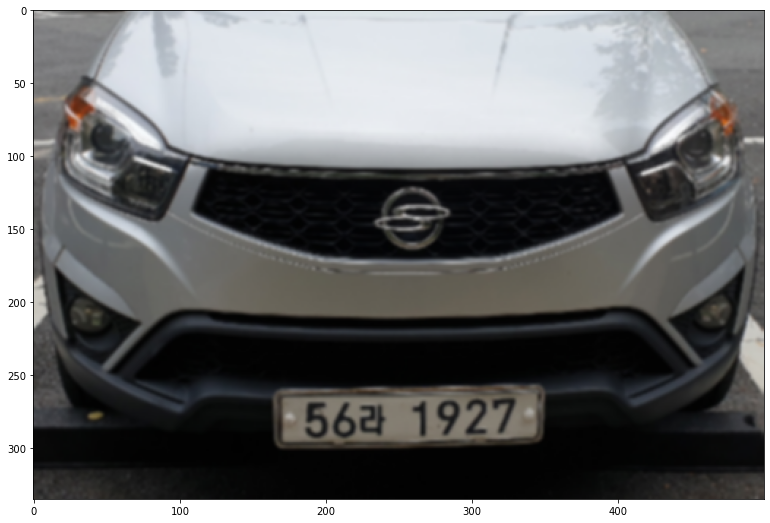

In [93]:
# GussianBlur
img_gaus = cv2.GaussianBlur(img_resize, (5,5), 0)

plt.imshow(cv2.cvtColor(img_gaus, cv2.COLOR_BGR2RGB))

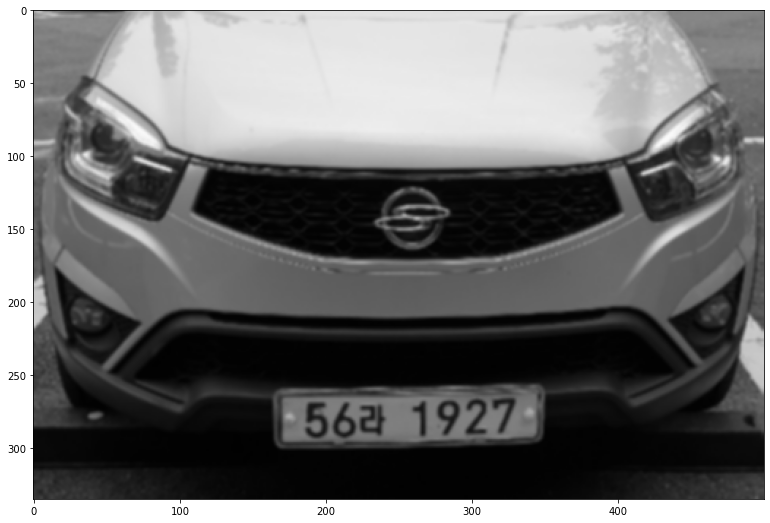

In [94]:
# 흑백이미지 
img_gray = cv2.cvtColor(img_gaus, cv2.COLOR_BGR2GRAY)

# RGB로 변환 후 이미지 출력
plt.imshow(cv2.cvtColor(img_gray,cv2.COLOR_BGR2RGB))

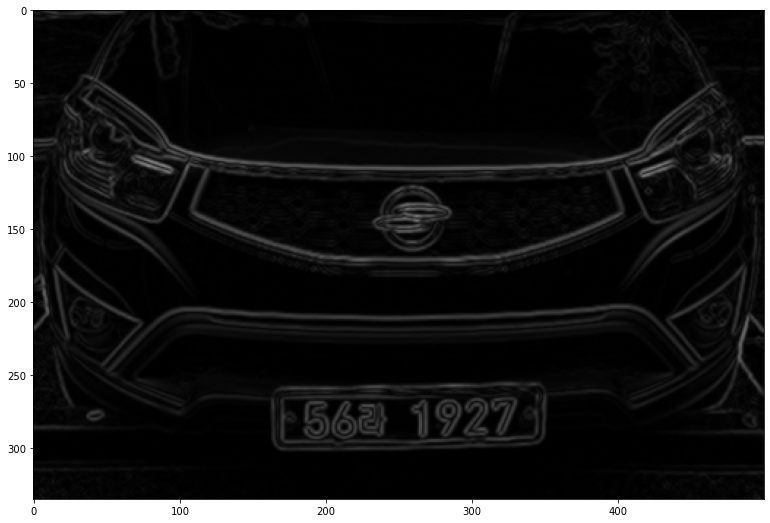

In [62]:
# 윤곽선
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (3,3))
image_mg = cv2.morphologyEx(img_gray, cv2.MORPH_GRADIENT,kernel)

plt.imshow(cv2.cvtColor(image_mg, cv2.COLOR_BGR2RGB))

In [63]:
def cov(img):
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

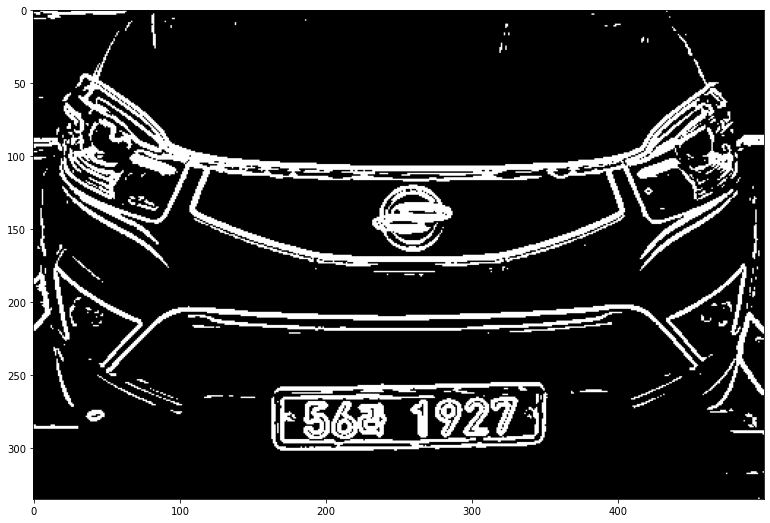

In [64]:
## 이미지 이진화 - thresholding
# 햐얀 윤곽선을 두껍게
_, image_bw = cv2.threshold(image_mg, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)

cov(image_bw)

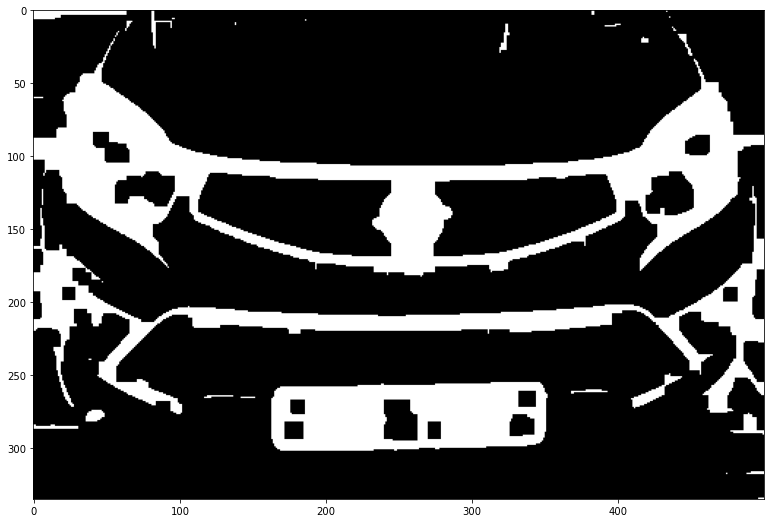

In [65]:
## image closing 
# 번호판 detect 위해서
# 하얀 면적이 크고 너비가 긴 사각형 = 번호판!
kernel =  cv2.getStructuringElement(cv2.MORPH_RECT,(9,9))
image_mc = cv2.morphologyEx(image_bw, cv2.MORPH_CLOSE,kernel)

cov(image_mc)

### 이미지 컨투어

In [85]:
# 이미지에서 윤곽 찾기
contours, hierarchy = cv2.findContours(image_mc.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

In [84]:
## 차량번호 저장
car_num = []

In [86]:
contours  # 사각형들 좌표

[array([[[496, 334]],
 
        [[497, 334]],
 
        [[498, 334]],
 
        [[499, 334]],
 
        [[498, 334]],
 
        [[497, 334]]], dtype=int32),
 array([[[474, 317]]], dtype=int32),
 array([[[491, 316]],
 
        [[490, 317]],
 
        [[489, 317]],
 
        [[488, 317]],
 
        [[489, 317]],
 
        [[490, 317]],
 
        [[491, 317]],
 
        [[492, 317]],
 
        [[493, 317]],
 
        [[494, 317]],
 
        [[495, 317]],
 
        [[496, 317]],
 
        [[497, 317]],
 
        [[498, 317]],
 
        [[499, 317]],
 
        [[499, 316]],
 
        [[498, 316]],
 
        [[497, 316]],
 
        [[496, 316]],
 
        [[495, 316]],
 
        [[494, 316]],
 
        [[493, 316]],
 
        [[492, 316]]], dtype=int32),
 array([[[  0, 284]],
 
        [[  0, 285]],
 
        [[  0, 286]],
 
        [[  1, 286]],
 
        [[  2, 286]],
 
        [[  3, 286]],
 
        [[  4, 286]],
 
        [[  5, 286]],
 
        [[  6, 286]],
 
        [[  7, 286]],
 
 

In [95]:
## 컨투어 검색
car_num = []
for idx in range(len(contours)):
    x,y,w,h = cv2.boundingRect(contours[idx])
    # 컨투어 내부 회색 비율
    # 검은색(0,0,0)이 아닌 것만 count (countNonZero)
    ratio = float(cv2.countNonZero(image_mc[y:y+h, x:x+w]))/(w*h)
    #번호판 식별 기준
    # 사각형이 전체 크기에 절반 이상, 너비가 150, 높이가 25 이상
    
    if ratio > 0.5 and w > 150 and h >35: 
        #사각형 표시 (detect)
        cv2.rectangle(img_gaus, (x,y), (x+w-1, y+h-1),(0,255,0),2)
        # 숫자로 변환 위해.
        # 이미지 자르기
        img_sub = img_gray[y:y+h, x:x+w] 
        # 이미지 이진화 검은색이 아니라면 255(흰색)
        _, img_sub = cv2.threshold(img_sub, 0 ,255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)
        # 추출된 이미지에서 글자 추출
        str = pytesseract.image_to_string(img_sub, lang = 'kor+eng')
        print(str)
        # 차량번호 저장
        car_num.append(str)

In [98]:
img_sub

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

In [96]:
car_num

['\x0c']

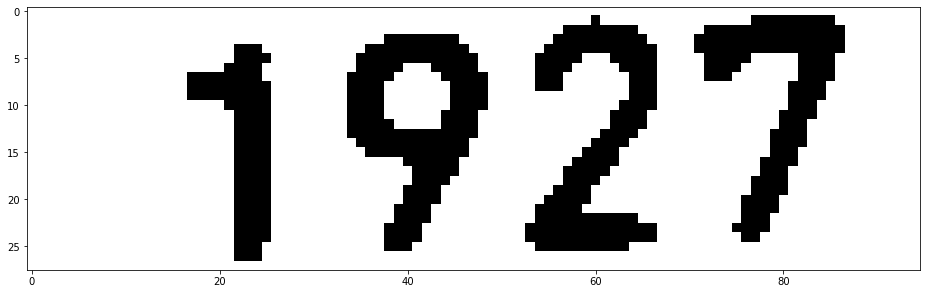

In [107]:
cov(img_sub[10:38,80:175])


In [117]:
str = pytesseract.image_to_string(img_raw[:500,:], lang = 'kor+eng')

In [118]:
str

' \n\x0c'

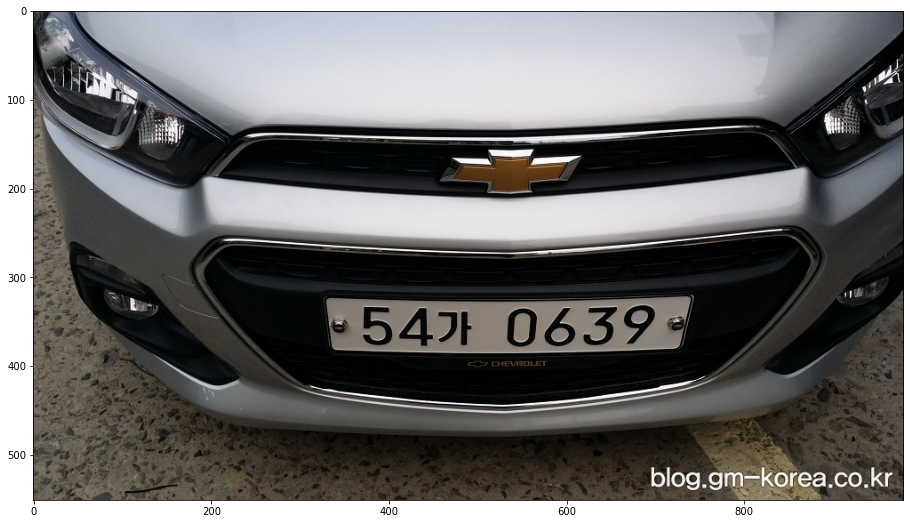

In [119]:
cov(img_raw)

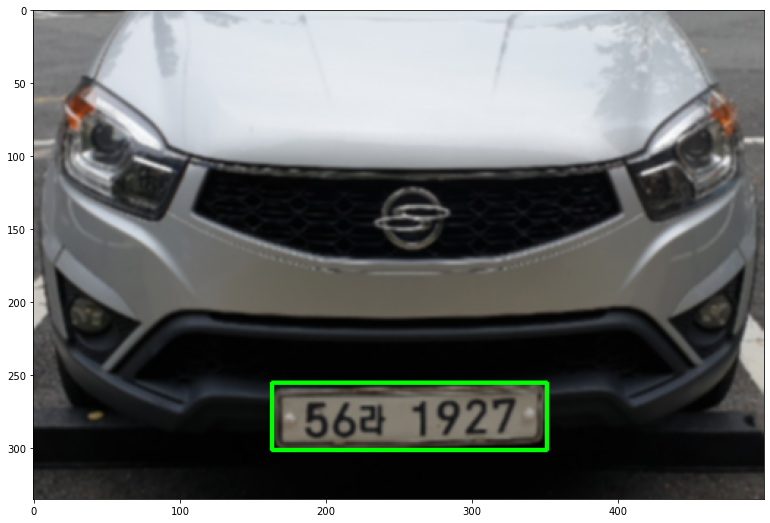

In [82]:
cov(img_gaus)